In [1]:
#%%

# ============================================================================
# 1. IMPORT LIBRARIES AND SET UP ENVIRONMENT
# ============================================================================

# Standard scientific computing libraries
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import pandas as pd

# PyTorch for deep learning
import torch
import torch.nn as nn
import torch.nn.functional as F

# Scipy for signal processing and interpolation
from scipy.ndimage import gaussian_filter
from scipy.interpolate import interp1d

# Custom utility modules for neural data analysis
from utils.loss import PoissonBPSAggregator
from utils.modules import SplitRelu, NonparametricReadout, StackedConv2d
from utils.datasets import DictDataset, generate_gaborium_dataset, generate_gratings_dataset
from utils.general import set_seeds, ensure_tensor
from utils.grid_sample import grid_sample_coords
from utils.rf import calc_sta, plot_stas
from utils.exp.general import get_clock_functions, get_trial_protocols
from utils.exp.dots import dots_rf_map_session
from utils.spikes import KilosortResults

# Matplotlib utilities
from matplotlib.patches import Circle

# MATLAB file loading
from mat73 import loadmat

# ============================================================================
# CONFIGURATION AND SETUP
# ============================================================================

# Set random seeds for reproducibility across runs
RANDOM_SEED = 1002
set_seeds(RANDOM_SEED)

# Configure PyTorch for optimal performance
torch.set_float32_matmul_precision('medium')  # Trade precision for speed

# Set device for computation (GPU if available, otherwise CPU)
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Using device: {device}")

# Define data directory path
data_dir = Path('/home/ryanress/YatesShifterExample/data')

Using device: cuda


In [2]:
#%%

# ============================================================================
# 2. LOAD EXPERIMENTAL DATA AND EYE TRACKING
# ============================================================================

# Load experimental metadata and stimulus information
exp_file = data_dir / 'Allen_2022-04-13_struct.mat'
exp = loadmat(exp_file)
print(f"Loaded experiment file: {exp_file}")

# Extract timing conversion functions for synchronizing different data streams
# ptb2ephys converts PsychToolbox timestamps to electrophysiology timestamps
ptb2ephys, vpx2ephys = get_clock_functions(exp)

# Load spike sorting results from Kilosort4
ks4_dir = data_dir / 'Allen_2022-04-13_ks4'
ks_results = KilosortResults(ks4_dir)
spike_times = ks_results.spike_times  # When each spike occurred
spike_clusters = ks_results.spike_clusters  # Which neuron each spike came from
cluster_ids = np.unique(spike_clusters)  # List of all neuron IDs
print(f"Loaded {len(cluster_ids)} neurons with {len(spike_times)} total spikes")

# Load eye tracking data (DPI = Digital Pupil Imaging)
ddpi_file = data_dir / 'Allen_2022-04-13_ddpi.csv'
eye_data = pd.read_csv(ddpi_file)
eye_times = eye_data['t_ephys'].values  # Timestamps for eye position samples
eye_positions_pixels = eye_data[['dpi_i', 'dpi_j']].values  # Eye position in screen pixels
eye_valid = eye_data['valid'].values  # Whether eye tracking was reliable at each time

# Create interpolation functions for eye position data
# This allows us to estimate eye position at any time point
eye_pos_interp = interp1d(eye_times, eye_positions_pixels,
                         kind='linear', fill_value='extrapolate', axis=0)
eye_valid_interp = interp1d(eye_times, eye_valid,
                           kind='nearest', fill_value='extrapolate')

# ============================================================================
# CONVERT EYE POSITIONS FROM PIXELS TO DEGREES OF VISUAL ANGLE
# ============================================================================
# Visual angle is the standard unit for measuring stimulus size in vision research
# It accounts for viewing distance and screen size

# Extract screen parameters from experiment metadata
screen_resolution = (exp['S']['screenRect'][2:] - exp['S']['screenRect'][:2]).astype(int)
screen_width_cm = exp['S']['screenWidth']  # Physical width in centimeters
screen_distance_cm = exp['S']['screenDistance']  # Distance from eye to screen
screen_height_cm = screen_width_cm * screen_resolution[1] / screen_resolution[0]
screen_center_pixels = np.flipud((screen_resolution + 1) / 2)

# Convert pixels to degrees using the calibrated conversion factor
pixels_per_degree = exp['S']['pixPerDeg']
eye_positions_degrees = (eye_positions_pixels - screen_center_pixels) / pixels_per_degree

# Flip and reorder coordinates to match standard conventions
# (azimuth = horizontal, elevation = vertical)
eye_positions_degrees[:, 0] *= -1  # Flip azimuth direction
eye_positions_degrees = eye_positions_degrees[:, [1, 0]]  # Swap to [azimuth, elevation]

# Create interpolation function for eye positions in degrees
eye_pos_deg_interp = interp1d(eye_times, eye_positions_degrees,
                             kind='linear', fill_value='extrapolate', axis=0)

print(f"Screen: {screen_resolution[0]}x{screen_resolution[1]} pixels, "
      f"{screen_width_cm:.1f}x{screen_height_cm:.1f} cm")
print(f"Viewing distance: {screen_distance_cm:.1f} cm")
print(f"Pixels per degree: {pixels_per_degree:.1f}")

Loaded experiment file: /home/ryanress/YatesShifterExample/data/Allen_2022-04-13_struct.mat
Loaded 146 neurons with 6612605 total spikes
Screen: 1280x720 pixels, 48.5x27.3 cm
Viewing distance: 79.0 cm
Pixels per degree: 37.5


In [3]:
#%%

# ============================================================================
# 3. RECEPTIVE FIELD MAPPING
# ============================================================================
# Map the spatial receptive fields of neurons using spike-triggered averages
# This tells us which part of the visual field each neuron responds to

# Temporal parameters for receptive field analysis
FRAME_RATE = 240  # Hz - stimulus refresh rate
dt = 1 / FRAME_RATE  # Time per frame in seconds
rf_lags = np.arange(7, 14)  # Frame delays to analyze (captures neural response latency)

# Spatial parameters for receptive field mapping
rf_roi_degrees = np.array([[-4, 4], [-4, 4]])  # [azimuth_range, elevation_range] in degrees
rf_spatial_resolution = 0.25  # degrees per pixel in RF map

print(f"Mapping receptive fields with {len(rf_lags)} time lags "
      f"({rf_lags[0]*dt*1000:.1f}-{rf_lags[-1]*dt*1000:.1f} ms)")
print(f"Spatial region: {rf_roi_degrees[0][0]}° to {rf_roi_degrees[0][1]}° azimuth, "
      f"{rf_roi_degrees[1][0]}° to {rf_roi_degrees[1][1]}° elevation")

# Compute receptive fields using dots stimulus
rf_results = dots_rf_map_session(exp, eye_data, ks_results,
                                dt=dt, lags=rf_lags,
                                roi_deg=rf_roi_degrees, dxy_deg=rf_spatial_resolution)

# Extract results
receptive_field_map = rf_results['rf']  # 2D map of neural response strength
azimuth_edges = rf_results['j_edges']  # Pixel coordinates for azimuth axis
elevation_edges = rf_results['i_edges']  # Pixel coordinates for elevation axis
rf_center_pixels = rf_results['rf_pix']  # Center of RF in pixel coordinates
rf_center_degrees = rf_results['rf_deg']  # Center of RF in degrees

print(f"Receptive field center: [{rf_center_degrees[0]:.1f}°, {rf_center_degrees[1]:.1f}°] "
      f"(pixels: [{rf_center_pixels[0]}, {rf_center_pixels[1]}])")

Mapping receptive fields with 7 time lags (29.2-54.2 ms)
Spatial region: -4° to 4° azimuth, -4° to 4° elevation
Found 32 ForageDots trials
Receptive field center: [-0.7°, 0.2°] (pixels: [-8, -27])


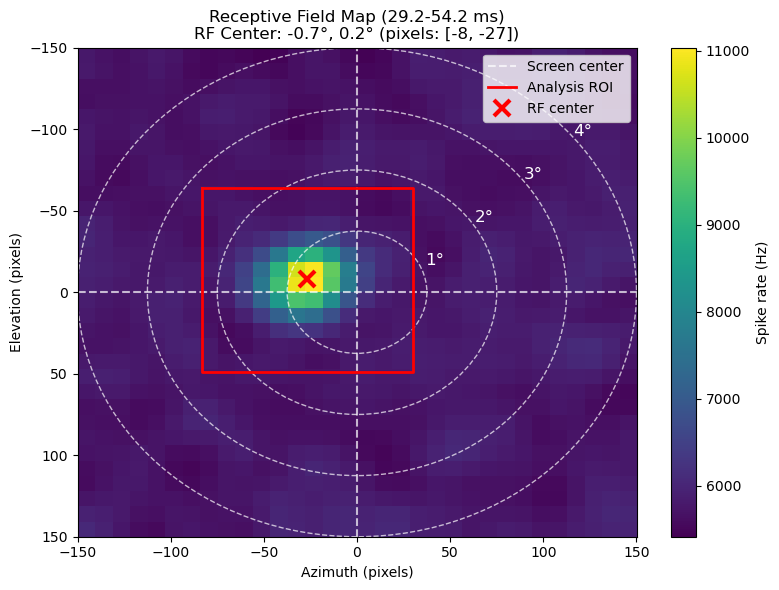

In [4]:
#%%

# ============================================================================
# VISUALIZE RECEPTIVE FIELD AND DEFINE ANALYSIS REGION
# ============================================================================

# Define region of interest around the receptive field center
roi_radius_degrees = 1.5  # degrees
roi_radius_pixels = int(roi_radius_degrees * pixels_per_degree)

# Create bounding box for analysis region (in pixel coordinates)
analysis_roi = np.stack([rf_center_pixels - roi_radius_pixels,
                        rf_center_pixels + roi_radius_pixels + 1], axis=1)

# Create visualization of receptive field map
plt.figure(figsize=(8, 6))
plt.imshow(receptive_field_map,
          extent=[azimuth_edges[0], azimuth_edges[-1],
                 elevation_edges[-1], elevation_edges[0]],
          aspect='auto', cmap='viridis')

# Add reference lines and circles
plt.axvline(0, color='white', linestyle='--', alpha=0.7, label='Screen center')
plt.axhline(0, color='white', linestyle='--', alpha=0.7)

# Add degree markers
for radius in np.arange(1, 5):
    circle = Circle((0, 0), radius * pixels_per_degree,
                   fill=False, color='white', linestyle='--', alpha=0.7)
    plt.gca().add_patch(circle)
    # Add degree labels
    label_x = np.sqrt(2)/2 * radius * pixels_per_degree + 10
    label_y = -np.sqrt(2)/2 * radius * pixels_per_degree + 10
    plt.text(label_x, label_y, f'{radius}°', color='white', fontsize=12)

# Highlight the analysis region
roi_corners_x = [analysis_roi[1, 0], analysis_roi[1, 1], analysis_roi[1, 1],
                analysis_roi[1, 0], analysis_roi[1, 0]]
roi_corners_y = [analysis_roi[0, 0], analysis_roi[0, 0], analysis_roi[0, 1],
                analysis_roi[0, 1], analysis_roi[0, 0]]
plt.plot(roi_corners_x, roi_corners_y, 'red', linewidth=2, label='Analysis ROI')

# Mark RF center
plt.plot(rf_center_pixels[1], rf_center_pixels[0], 'rx', markersize=12,
         markeredgewidth=3, label='RF center')

plt.colorbar(label='Spike rate (Hz)')
plt.title(f'Receptive Field Map ({rf_lags[0]*dt*1000:.1f}-{rf_lags[-1]*dt*1000:.1f} ms)\n'
          f'RF Center: {rf_center_degrees[0]:.1f}°, {rf_center_degrees[1]:.1f}° '
          f'(pixels: [{rf_center_pixels[0]}, {rf_center_pixels[1]}])')
plt.xlabel('Azimuth (pixels)')
plt.ylabel('Elevation (pixels)')
plt.legend()
plt.tight_layout()
plt.show()

In [5]:
#%%

# ============================================================================
# 4. DATASET GENERATION AND LOADING
# ============================================================================
# Generate or load the main dataset used for training the shifter model

# Get information about all experimental protocols
experimental_protocols = get_trial_protocols(exp)
print(f"Found {len(experimental_protocols)} experimental protocols")

# Create metadata dictionary to store experimental parameters
experiment_metadata = {
    'screen_resolution': screen_resolution,
    'screen_width': screen_width_cm,
    'screen_height': screen_height_cm,
    'screen_distance': screen_distance_cm,
    'pixels_per_degree': pixels_per_degree,
    'analysis_roi': analysis_roi,
}

# Generate or load the Gaborium dataset
# Gaborium stimuli are complex textures made of many overlapping Gabor patches
# These provide rich visual input for training neural response models
gaborium_dataset_file = data_dir / 'gaborium.dset'

if gaborium_dataset_file.exists():
    print("Loading existing Gaborium dataset...")
    dataset = DictDataset.load(gaborium_dataset_file)
else:
    print("Generating new Gaborium dataset (this may take several minutes)...")
    dataset = generate_gaborium_dataset(
        exp, ks_results, analysis_roi,
        eye_pos_interp, eye_pos_deg_interp, eye_valid_interp,
        dt=dt, metadata=experiment_metadata
    )
    dataset.save(gaborium_dataset_file)
    print(f"Dataset saved to {gaborium_dataset_file}")

print(f"Dataset contains {len(dataset)} time points")

Found 685 experimental protocols
Loading existing Gaborium dataset...
Dataset contains 191887 time points


In [6]:
#%%

# ============================================================================
# 5. DATA PREPROCESSING AND QUALITY CONTROL
# ============================================================================
# Clean and prepare the data for model training

# Define quality control parameters
MAX_EYE_MOVEMENT = 10  # degrees - exclude data with large eye movements
N_TIME_LAGS = 20  # number of temporal lags to consider for STA analysis

print("Preprocessing dataset...")

# Normalize stimulus values to have zero mean and unit variance
# This helps with neural network training stability
dataset['stim'] = dataset['stim'].float()
stimulus_mean = dataset['stim'].mean()
stimulus_std = dataset['stim'].std()
dataset['stim'] = (dataset['stim'] - stimulus_mean) / stimulus_std
print(f"Normalized stimulus: mean={stimulus_mean:.3f}, std={stimulus_std:.3f}")

# Create mask for valid data points
# We exclude time points where:
# 1. Eye movements are too large (> MAX_EYE_MOVEMENT degrees)
# 2. Eye tracking was unreliable
# 3. We don't have enough history for temporal analysis
print("Creating validity mask...")

valid_eye_positions = np.logical_and.reduce([
    np.abs(dataset['eyepos'][:, 0]) < MAX_EYE_MOVEMENT,  # Azimuth within bounds
    np.abs(dataset['eyepos'][:, 1]) < MAX_EYE_MOVEMENT,  # Elevation within bounds
    dataset['dpi_valid']  # Eye tracking was reliable
])

# Ensure we have valid data for all required time lags
# This prevents using data points that don't have sufficient history
for lag in range(N_TIME_LAGS):
    valid_eye_positions &= np.roll(valid_eye_positions, 1, axis=0)

valid_indices = np.where(valid_eye_positions)[0]
print(f"Valid data points: {len(valid_indices):,} / {len(dataset):,} "
      f"({100 * len(valid_indices) / len(dataset):.1f}%)")

Preprocessing dataset...
Normalized stimulus: mean=127.266, std=34.102
Creating validity mask...
Valid data points: 168,498 / 191,887 (87.8%)


/tmp/ipykernel_4099378/4208584686.py:30: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  np.abs(dataset['eyepos'][:, 0]) < MAX_EYE_MOVEMENT,  # Azimuth within bounds
/tmp/ipykernel_4099378/4208584686.py:31: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  np.abs(dataset['eyepos'][:, 1]) < MAX_EYE_MOVEMENT,  # Elevation within bounds


Analyzing neural response timing...


Calculating STA: 100%|██████████| 340/340 [00:25<00:00, 13.50it/s]


Computed STEs for 146 units, 20 time lags
Optimal response lags range from 0 to 19 frames
(0.0 to 79.2 ms)
Aligning neural responses to optimal lags...
Unit selection results:
  - Units with SNR > 5: 91
  - Units with > 500 spikes: 127
  - Units passing both criteria: 87
Plotting spike-triggered energies...


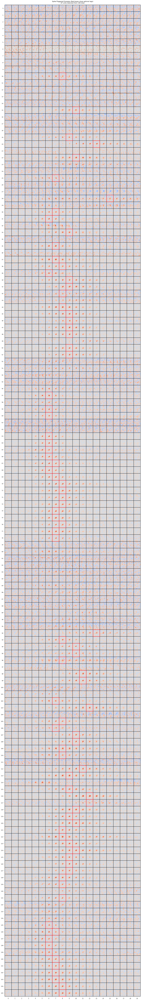

Final dataset: 168478 timepoints, 87 units


In [ ]:
#%%

# ============================================================================
# 6. NEURAL RESPONSE ANALYSIS AND UNIT SELECTION
# ============================================================================
# Analyze neural responses to find optimal timing and select high-quality units

# Quality thresholds for unit selection
SNR_THRESHOLD = 5  # Signal-to-noise ratio threshold
MIN_SPIKE_COUNT = 500  # Minimum number of spikes required per unit

print("Analyzing neural response timing...")

# Calculate spike-triggered stimulus energy (STE)
# STE measures how much stimulus energy drives each neuron at different time lags
# This helps us find the optimal delay between stimulus and neural response
spike_triggered_energies = calc_sta(
    dataset['stim'], dataset['robs'],
    N_TIME_LAGS, inds=valid_indices, device=device, batch_size=10000,
    stim_modifier=lambda x: x**2,  # Square stimulus to get energy
    progress=True
).cpu().numpy()

print(f"Computed STEs for {spike_triggered_energies.shape[0]} units, "
      f"{spike_triggered_energies.shape[1]} time lags")

# Find the optimal response lag for each neuron
# We look for the lag that gives the strongest, most reliable response
signal_strength = np.abs(spike_triggered_energies -
                        np.median(spike_triggered_energies, axis=(2,3), keepdims=True))

# Apply spatial smoothing to reduce noise
smoothing_kernel = [0, 2, 2, 2]  # No temporal smoothing, 2-pixel spatial smoothing
signal_strength = gaussian_filter(signal_strength, smoothing_kernel)

# Calculate signal-to-noise ratio for each unit and lag
noise_level = np.median(signal_strength[:, 0], axis=(1,2))  # Use first lag as noise estimate
signal_to_noise = np.max(signal_strength, axis=(2,3)) / noise_level[:, None]
optimal_lag_per_unit = signal_to_noise.argmax(axis=1)

print(f"Optimal response lags range from {optimal_lag_per_unit.min()} to {optimal_lag_per_unit.max()} frames")
print(f"({optimal_lag_per_unit.min()*dt*1000:.1f} to {optimal_lag_per_unit.max()*dt*1000:.1f} ms)")

# Align neural responses to optimal lag for each unit
print("Aligning neural responses to optimal lags...")
n_timepoints = len(dataset['robs'])
robs_original = dataset['robs']
aligned_responses = []

for unit_idx in range(dataset['robs'].shape[1]):
    lag = optimal_lag_per_unit[unit_idx]
    # Extract responses starting from the optimal lag
    max_timepoint = n_timepoints + lag - N_TIME_LAGS
    unit_responses = dataset['robs'][lag:max_timepoint, unit_idx]
    aligned_responses.append(unit_responses)

aligned_responses = torch.stack(aligned_responses, axis=1)

# Update dataset with aligned responses
dataset.replicates = True  # Allow modification of dataset length
dataset = dataset[:-N_TIME_LAGS]  # Remove timepoints without sufficient history
dataset['robs'] = aligned_responses
dataset = dataset[valid_eye_positions[:-N_TIME_LAGS]]  # Apply validity mask
dataset.replicates = False

# Select high-quality units based on signal-to-noise ratio and spike count
max_snr_per_unit = np.max(signal_to_noise, axis=1)
total_spikes_per_unit = dataset['robs'].sum(0)

high_snr_units = np.where(max_snr_per_unit > SNR_THRESHOLD)[0]
high_activity_units = np.where(total_spikes_per_unit > MIN_SPIKE_COUNT)[0]
good_units = np.intersect1d(high_snr_units, high_activity_units)

print(f"Unit selection results:")
print(f"  - Units with SNR > {SNR_THRESHOLD}: {len(high_snr_units)}")
print(f"  - Units with > {MIN_SPIKE_COUNT} spikes: {len(high_activity_units)}")
print(f"  - Units passing both criteria: {len(good_units)}")

# Keep only high-quality units
dataset['robs'] = dataset['robs'][:, good_units]
n_units = len(good_units)

# Visualize spike-triggered energies with optimal lags highlighted
print("Plotting spike-triggered energies...")
normalized_stes = (spike_triggered_energies -
                  np.median(spike_triggered_energies, axis=(2,3), keepdims=True))
fig, axs = plot_stas(normalized_stes[:, :, None, :, :])

# Highlight optimal lag for each good unit
for i, unit_idx in enumerate(good_units):
    lag = optimal_lag_per_unit[unit_idx]
    # Draw rectangle around optimal lag
    x0, x1 = lag, lag + 1
    y0, y1 = -unit_idx - 1, -unit_idx
    axs.plot([x0, x1, x1, x0, x0], [y1, y1, y0, y0, y1], 'r-', linewidth=2)

plt.title(f'Spike-Triggered Energies (Red boxes show optimal lags)\n'
          f'{len(good_units)} units selected from {spike_triggered_energies.shape[0]} total')
plt.show()

print(f"Final dataset: {len(dataset)} timepoints, {n_units} units")

In [8]:
#%%

# ============================================================================
# 7. PREPARE DATA FOR MODEL TRAINING
# ============================================================================
# Convert data types and create spatial grid for the shifter model

print("Preparing data for model training...")

# Ensure all tensor data is in float32 format for consistent computation
for key in dataset.keys():
    if torch.is_tensor(dataset[key]):
        dataset[key] = dataset[key].to(torch.float32)

print("Dataset summary:")
print(dataset)

Preparing data for model training...
Dataset summary:
DictDataset
	t_bins (cpu): 658.12 KB - 168478 (torch.float32)
	trial_inds (cpu): 658.12 KB - 168478 (torch.float32)
	stim (cpu): 8.01 GB - 168478 x 113 x 113 (torch.float32)
	robs (cpu): 55.91 MB - 168478 x 87 (torch.float32)
	dpi_pix (cpu): 1.29 MB - 168478 x 2 (torch.float32)
	eyepos (cpu): 1.29 MB - 168478 x 2 (torch.float32)
	dpi_valid (cpu): 658.12 KB - 168478 (torch.float32)
	roi (cpu): 2.57 MB - 168478 x 2 x 2 (torch.float32)
	Metadata:
		screen_resolution: ndarray
		screen_width: ndarray
		screen_height: float64
		screen_distance: ndarray
		ppd: ndarray
		roi_src: ndarray



Creating spatial grid with radius 25 pixels...


/tmp/ipykernel_4099378/4006468211.py:39: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  coordinate_grid += grid_center[None, None, :]


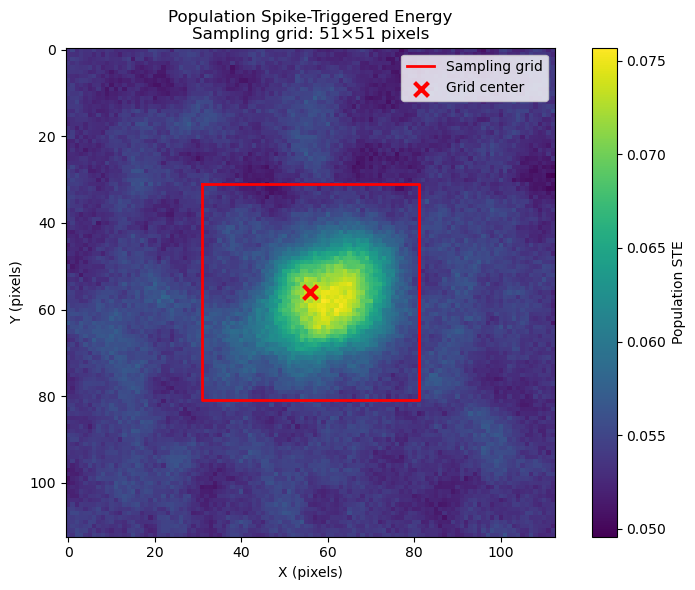

Grid center: [56, 56]
Grid size: 51×51 pixels
Updated dataset metadata


In [9]:
#%%

# ============================================================================
# CREATE SPATIAL SAMPLING GRID FOR SHIFTER MODEL
# ============================================================================
# The shifter model needs a spatial grid to sample from when correcting for eye movements

GRID_RADIUS = 25  # pixels - how far the model can shift the stimulus

print(f"Creating spatial grid with radius {GRID_RADIUS} pixels...")

# Get dimensions of the stimulus
_, _, stimulus_height, stimulus_width = spike_triggered_energies.shape

# Calculate population-weighted average of spike-triggered energies
# This helps us find the center of the population response
response_weights = (dataset['robs'].sum(dim=0) / dataset['robs'].sum()).cpu().numpy()
population_ste = np.zeros((stimulus_height, stimulus_width))

for i, unit_idx in enumerate(good_units):
    optimal_lag = optimal_lag_per_unit[unit_idx]
    population_ste += spike_triggered_energies[unit_idx, optimal_lag] * response_weights[i]

# Center the grid on the stimulus center
grid_center = np.array((stimulus_width, stimulus_height)) // 2

# Create coordinate grid for spatial sampling
# This defines all possible pixel locations the model can sample from
coordinate_grid = torch.stack(
    torch.meshgrid(
        torch.arange(-GRID_RADIUS, GRID_RADIUS + 1),
        torch.arange(-GRID_RADIUS, GRID_RADIUS + 1),
        indexing='xy'
    ),
    dim=-1
).float()

# Offset grid to be centered on the stimulus center
coordinate_grid += grid_center[None, None, :]

# Get grid boundaries for visualization
x_min, x_max = coordinate_grid[..., 0].min(), coordinate_grid[..., 0].max()
y_min, y_max = coordinate_grid[..., 1].min(), coordinate_grid[..., 1].max()

# Visualize the population response and sampling grid
fig, ax = plt.subplots(1, 1, figsize=(8, 6))
im = ax.imshow(population_ste, cmap='viridis', origin='upper')
fig.colorbar(im, ax=ax, label='Population STE')

# Draw grid boundaries
grid_corners_x = [x_min, x_min, x_max, x_max, x_min]
grid_corners_y = [y_min, y_max, y_max, y_min, y_min]
ax.plot(grid_corners_x, grid_corners_y, color='red', linewidth=2, label='Sampling grid')

# Mark grid center
ax.scatter([grid_center[0]], [grid_center[1]], color='red', marker='x',
          s=100, linewidth=3, label='Grid center')

ax.set_title(f'Population Spike-Triggered Energy\nSampling grid: {2*GRID_RADIUS+1}×{2*GRID_RADIUS+1} pixels')
ax.set_xlabel('X (pixels)')
ax.set_ylabel('Y (pixels)')
ax.legend()
plt.tight_layout()
plt.show()

# Store metadata for model training
dataset.metadata['max_eye_movement'] = MAX_EYE_MOVEMENT
dataset.metadata['grid_center'] = grid_center
dataset.metadata['snr_threshold'] = SNR_THRESHOLD
dataset.metadata['min_spike_count'] = MIN_SPIKE_COUNT
dataset.metadata['coordinate_grid'] = coordinate_grid

print(f"Grid center: [{grid_center[0]}, {grid_center[1]}]")
print(f"Grid size: {2*GRID_RADIUS+1}×{2*GRID_RADIUS+1} pixels")
print("Updated dataset metadata")

In [10]:
#%%

# ============================================================================
# 8. MODEL ARCHITECTURE DEFINITIONS
# ============================================================================
# Define the neural network models for eye movement correction and stimulus processing

class MLPPixelShifter(nn.Module):
    """
    Multi-Layer Perceptron that predicts pixel shifts based on eye position.

    This model learns to map eye positions (in degrees) to pixel shifts that
    compensate for eye movements. The key insight is that small eye movements
    can be corrected by shifting the stimulus in the opposite direction.

    Parameters:
    -----------
    grid : torch.Tensor
        Spatial coordinate grid defining possible sampling locations
    hidden_dims : int or list
        Number of hidden units in each layer
    weight_init_multiplier : float
        Scaling factor for weight initialization
    input_dim : int
        Dimensionality of input (2 for [azimuth, elevation])
    anchored : bool
        Whether to anchor shifts to zero at the origin
    mode : str
        Interpolation mode ('bilinear' or 'nearest')
    """

    def __init__(self, grid, hidden_dims=100, weight_init_multiplier=1,
                 input_dim=2, anchored=True, mode='bilinear'):
        super(MLPPixelShifter, self).__init__()

        self.input_dim = input_dim
        self.grid = nn.Parameter(grid.float(), requires_grad=False)
        self.hidden_dims = hidden_dims
        self.weight_init_multiplier = weight_init_multiplier
        self.anchored = anchored
        self.set_mode(mode)

        # Convert scalar hidden_dims to list
        if isinstance(hidden_dims, int):
            hidden_dims = [hidden_dims]

        # Build MLP layers
        layers = []
        for i in range(len(hidden_dims)):
            if i == 0:
                layers.append(nn.Linear(input_dim, hidden_dims[0]))
            else:
                layers.append(nn.Linear(hidden_dims[i-1], hidden_dims[i], bias=True))
            layers.append(nn.GELU())  # Smooth activation function

        # Output layer: predict 2D pixel shift
        layers.append(nn.Linear(hidden_dims[-1], 2, bias=True))
        self.layers = nn.Sequential(*layers)

        # Initialize weights with custom scaling
        for layer in self.layers:
            if isinstance(layer, nn.Linear):
                layer.weight.data *= weight_init_multiplier

    def anchor(self):
        """Ensure that zero eye position produces zero shift."""
        zero_input = torch.zeros(self.input_dim, device=self.grid.device)
        zero_shift = self.layers(zero_input)
        self.layers[-1].bias.data -= zero_shift

    def set_mode(self, mode):
        """Set interpolation mode for spatial sampling."""
        assert mode in ['nearest', 'bilinear'], 'mode must be "nearest" or "bilinear"'
        self.mode = mode

    def forward(self, x):
        """
        Apply eye movement correction to stimulus.

        Parameters:
        -----------
        x : dict
            Dictionary containing 'stim' (stimulus) and 'eyepos' (eye position)

        Returns:
        --------
        dict
            Updated dictionary with corrected stimulus and shift information
        """
        if self.anchored:
            self.anchor()

        # Store original stimulus for comparison
        x['stim_in'] = x['stim']
        stimulus = x['stim']

        # Add channel dimension if missing
        if stimulus.ndim == 3:
            stimulus = stimulus.unsqueeze(1)

        n_frames, _, n_y, n_x = stimulus.shape

        # Predict pixel shifts from eye positions
        eye_position = x['eyepos']
        predicted_shifts = self.layers(eye_position).squeeze(dim=1)

        # Create shifted sampling grid
        # Add predicted shifts to base coordinate grid
        shifted_grid = predicted_shifts[:, None, None, :] + self.grid[None, ...]
        _, n_y_grid, n_x_grid, _ = shifted_grid.shape

        # Create temporal coordinate grid
        frame_indices = torch.arange(n_frames, device=self.grid.device).float()
        frame_grid = frame_indices.repeat(n_y_grid, n_x_grid, 1).permute(2, 0, 1).unsqueeze(-1)

        # Combine spatial and temporal coordinates
        sampling_grid = torch.cat([shifted_grid, frame_grid], dim=-1)

        # Define valid coordinate ranges
        coordinate_bounds = [
            [0, n_frames - 1],  # Temporal bounds
            [0, n_y - 1],       # Vertical bounds
            [0, n_x - 1]        # Horizontal bounds
        ]

        # Sample from stimulus using shifted coordinates
        corrected_stimulus = grid_sample_coords(
            stimulus.permute(1, 0, 2, 3)[None, ...],  # Reshape to [1, C, T, Y, X]
            sampling_grid[None, ...],
            coordinate_bounds,
            mode=self.mode,
            padding_mode='zeros',
            align_corners=True,
            no_grad=False
        )

        corrected_stimulus = corrected_stimulus.squeeze(dim=(0, 1))

        # Update dictionary with results
        x['shift_out'] = predicted_shifts
        x['stim'] = corrected_stimulus

        return x

    def plot_shifts(self, x_min, x_max, y_min, y_max, v_max=None,
                   image_resolution=50, quiver_resolution=10):
        """
        Visualize the learned shift function.

        Creates a heatmap showing shift magnitude and arrows showing shift direction
        across the range of possible eye positions.
        """
        with torch.no_grad():
            # Create high-resolution grid for smooth heatmap
            x_hires = torch.linspace(x_min, x_max, image_resolution, device=self.grid.device)
            y_hires = torch.linspace(y_min, y_max, image_resolution, device=self.grid.device)
            xy_hires = torch.stack(torch.meshgrid(x_hires, y_hires, indexing='xy'), dim=-1)

            # Create lower-resolution grid for arrow visualization
            x_arrows = torch.linspace(x_min, x_max, quiver_resolution, device=self.grid.device)
            y_arrows = torch.linspace(y_min, y_max, quiver_resolution, device=self.grid.device)
            xy_arrows = torch.stack(torch.meshgrid(x_arrows, y_arrows, indexing='xy'), dim=-1)

            # Compute shifts
            shift_magnitude = self.layers(xy_hires).norm(dim=-1)
            shift_vectors = self.layers(xy_arrows)

        # Create visualization
        fig, ax = plt.subplots(1, 1, figsize=(8, 6))

        # Heatmap of shift magnitude
        im = ax.imshow(shift_magnitude.cpu(), extent=[x_min, x_max, y_min, y_max],
                      vmin=0, vmax=v_max,
                      origin='lower', cmap='viridis')
        fig.colorbar(im, ax=ax, label='Shift magnitude (pixels)')

        # Arrow plot showing shift direction
        ax.quiver(xy_arrows[..., 0].cpu(), xy_arrows[..., 1].cpu(),
                 shift_vectors[..., 1].cpu(), -shift_vectors[..., 0].cpu(),
                 color='red', alpha=0.7)

        ax.set_xlabel('Eye position X (degrees)')
        ax.set_ylabel('Eye position Y (degrees)')
        ax.set_title('Learned Eye Movement Correction Function')

        return fig, ax

class StimulusCNN(nn.Module):
    """
    Convolutional Neural Network for processing visual stimuli and predicting neural responses.

    This CNN takes the (potentially shifted) stimulus and predicts the firing rate
    of each neuron. It uses a cascade of convolutional layers followed by a
    nonparametric readout that maps features to individual neurons.

    Parameters:
    -----------
    dims : tuple
        Input dimensions (channels, height, width)
    kernel_sizes : int or list
        Convolutional kernel sizes for each layer
    channels : int or list
        Number of output channels for each convolutional layer
    n_units : int
        Number of neurons to predict
    strides : list, optional
        Stride for each convolutional layer
    normalize_spatial_weights : bool
        Whether to normalize spatial readout weights
    fr_init : array-like, optional
        Initial firing rates for bias initialization
    """

    def __init__(self, dims, kernel_sizes, channels, n_units, strides=None,
                 normalize_spatial_weights=False, fr_init=None):
        super(StimulusCNN, self).__init__()

        self.dims = dims
        self.normalize_spatial_weights = normalize_spatial_weights

        # Convert scalars to lists for consistency
        if isinstance(kernel_sizes, int):
            kernel_sizes = [kernel_sizes]
        if isinstance(channels, int):
            channels = [channels]

        # Validate input dimensions
        assert len(kernel_sizes) == len(channels), \
            'kernel_sizes and channels must have the same length'

        if strides is None:
            strides = [1] * len(kernel_sizes)
        assert len(strides) == len(kernel_sizes), \
            'strides must have the same length as kernel_sizes'

        # Build convolutional layers
        n_layers = len(kernel_sizes)
        layers = []

        for i in range(n_layers):
            # Input channels: original dims for first layer, doubled for subsequent layers (due to SplitRelu)
            in_channels = dims[0] if i == 0 else channels[i-1] * 2
            out_channels = channels[i]

            # Add convolutional layer with batch normalization and split ReLU
            layers.append(StackedConv2d(in_channels, out_channels, kernel_sizes[i],
                                      stride=strides[i], bias=False))
            layers.append(nn.BatchNorm2d(out_channels))
            layers.append(SplitRelu())  # Doubles the number of channels

        # Calculate output spatial dimensions after convolutions
        height, width = dims[1], dims[2]
        for i in range(n_layers):
            height = (height - kernel_sizes[i]) // strides[i] + 1
            width = (width - kernel_sizes[i]) // strides[i] + 1

        # Final feature dimensions (channels doubled by SplitRelu)
        feature_dims = [channels[-1] * 2, height, width]

        # Add readout layer that maps features to individual neurons
        readout = NonparametricReadout(feature_dims, n_units)
        layers.append(readout)

        # Add softplus activation to ensure positive firing rates
        layers.append(nn.Softplus())

        self.layers = nn.Sequential(*layers)

        # Initialize readout biases based on observed firing rates
        if fr_init is not None:
            assert len(fr_init) == n_units, 'fr_init must have the same length as n_units'
            # Use inverse softplus to set appropriate bias values
            inv_softplus = lambda x, beta=1: torch.log(torch.exp(beta * x) - 1) / beta
            self.layers[-2].bias.data = inv_softplus(
                ensure_tensor(fr_init, device=self.layers[-2].bias.device)
            )

    def forward(self, x):
        """
        Process stimulus and predict neural responses.

        Parameters:
        -----------
        x : dict
            Dictionary containing 'stim' (stimulus tensor)

        Returns:
        --------
        dict
            Updated dictionary with 'rhat' (predicted firing rates)
        """
        # Normalize spatial weights if requested
        for layer in self.layers:
            if hasattr(layer, 'normalize_spatial_weights'):
                layer.normalize_spatial_weights()

        stimulus = x['stim'].float()

        # Add channel dimension if missing
        if stimulus.ndim == 3:
            stimulus = stimulus.unsqueeze(1)

        # Predict firing rates
        predicted_rates = self.layers(stimulus).squeeze()
        x['rhat'] = predicted_rates

        return x


class ShifterModel(nn.Module):
    """
    Complete model combining eye movement correction and neural response prediction.

    This model first applies the shifter to correct for eye movements, then
    uses the CNN to predict neural responses from the corrected stimulus.
    """

    def __init__(self, shifter_params, cnn_params):
        super(ShifterModel, self).__init__()
        self.shifter = MLPPixelShifter(**shifter_params)
        self.cnn = StimulusCNN(**cnn_params)

    def forward(self, x):
        """Apply eye movement correction followed by neural response prediction."""
        x = self.shifter(x)  # Correct for eye movements
        x = self.cnn(x)      # Predict neural responses
        return x

In [11]:
#%%

# ============================================================================
# 9. MODEL TRAINING SETUP
# ============================================================================
# Configure data loaders, model parameters, and training procedures

print("Setting up model training...")

# Data loading configuration
BATCH_SIZE = 128
# Move dataset to device
dataset = dataset.to(device)

# Split dataset into training and validation sets
train_dataset, validation_dataset = torch.utils.data.random_split(dataset, [0.8, 0.2])
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = torch.utils.data.DataLoader(validation_dataset, batch_size=BATCH_SIZE, shuffle=False)

print(f"Training set: {len(train_dataset):,} samples")
print(f"Validation set: {len(validation_dataset):,} samples")
print(f"Batch size: {BATCH_SIZE}")

# Shifter model parameters
shifter_config = {
    'grid': dataset.metadata['coordinate_grid'],
    'weight_init_multiplier': 1.0,  # Standard weight initialization
    'hidden_dims': [400],  # Single hidden layer with 400 units
    'anchored': True,  # Ensure zero eye position gives zero shift
    'mode': 'bilinear'  # Smooth interpolation
}

# CNN model parameters
cnn_config = {
    'dims': (1, dataset.metadata['coordinate_grid'].shape[0],
             dataset.metadata['coordinate_grid'].shape[1]),
    'kernel_sizes': [21, 11],  # Large then smaller receptive fields
    'channels': [16, 16],  # Number of feature maps per layer
    'n_units': n_units,
    'normalize_spatial_weights': False,
    'fr_init': train_dataset[:]['robs'].mean(dim=0),  # Initialize with observed rates
}

print(f"Shifter grid size: {dataset.metadata['coordinate_grid'].shape}")
print(f"CNN input dimensions: {cnn_config['dims']}")
print(f"Predicting responses for {n_units} neurons")

Setting up model training...
Training set: 134,783 samples
Validation set: 33,695 samples
Batch size: 128
Shifter grid size: torch.Size([51, 51, 2])
CNN input dimensions: (1, 51, 51)
Predicting responses for 87 neurons


Initializing model...
Model moved to cuda
Visualizing initial shifter function...


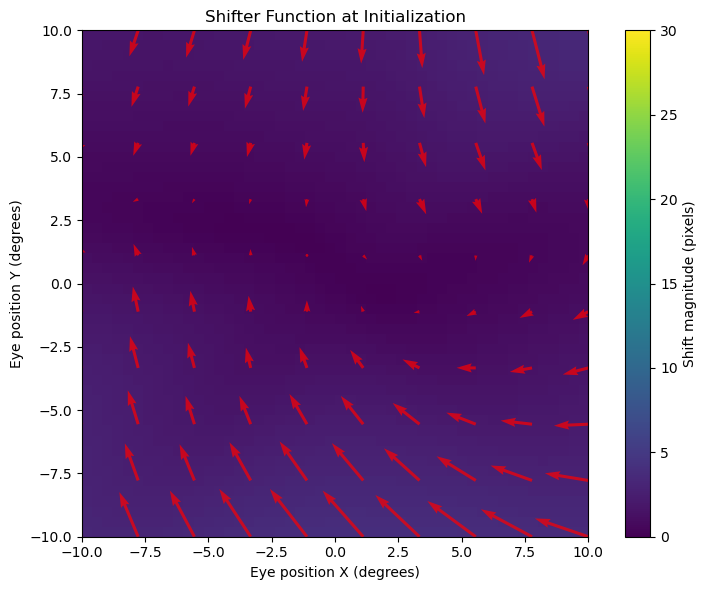

Initial model performance:


Validation: 100%|██████████| 264/264 [00:01<00:00, 214.68it/s]


Validation BPS: -0.0022

Starting training for 1 epochs...


Epoch 1: 100%|██████████| 1053/1053 [00:10<00:00, 97.09it/s, loss=0.1614] 


Epoch 1 - Average training loss: 0.1454


Validation: 100%|██████████| 264/264 [00:00<00:00, 266.88it/s]


Validation BPS: 0.3295
Epoch 1 complete - Loss: 0.1454, BPS: 0.3295

Visualizing learned shifter function...


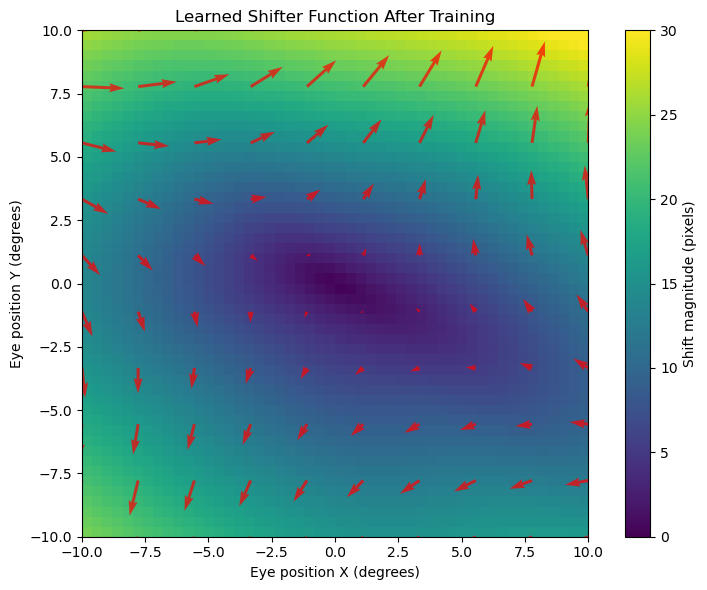

Training complete!


In [12]:
#%%

# ============================================================================
# 10. MODEL TRAINING AND OPTIMIZATION
# ============================================================================
# Train the shifter model to learn eye movement corrections

# Optimizer configuration
LEARNING_RATE = 1e-3
WEIGHT_DECAY = 1e-3  # L2 regularization
N_EPOCHS = 1  # Number of training epochs (increase for better performance)

optimizer_config = {
    'lr': LEARNING_RATE,
    'weight_decay': WEIGHT_DECAY,
    'betas': (0.9, 0.999),  # Adam momentum parameters
}

# Initialize model and optimizer
print("Initializing model...")
model = ShifterModel(shifter_config, cnn_config)
optimizer = torch.optim.AdamW(model.parameters(), **optimizer_config)

# Move model to GPU if available
model = model.to(device)
print(f"Model moved to {device}")

# Validation metric aggregator
validation_aggregator = PoissonBPSAggregator()

def train_epoch(epoch_num):
    """Train the model for one epoch."""
    model.train()
    total_loss = 0
    n_batches = 0

    progress_bar = tqdm(train_loader, desc=f'Epoch {epoch_num}')
    for batch in progress_bar:
        # Move batch to device
        for key in batch:
            if torch.is_tensor(batch[key]):
                batch[key] = batch[key].to(device)

        # Forward pass
        optimizer.zero_grad()
        output = model(batch)

        # Compute Poisson negative log-likelihood loss
        loss = F.poisson_nll_loss(output['rhat'], batch['robs'],
                                 log_input=False, full=False)

        # Backward pass
        loss.backward()
        optimizer.step()

        # Track metrics
        total_loss += loss.item()
        n_batches += 1
        progress_bar.set_postfix({'loss': f'{loss.item():.4f}'})

    avg_loss = total_loss / n_batches
    print(f'Epoch {epoch_num} - Average training loss: {avg_loss:.4f}')
    return avg_loss

def validate():
    """Evaluate model on validation set."""
    model.eval()
    validation_aggregator.reset()

    with torch.no_grad():
        for batch in tqdm(val_loader, desc='Validation'):
            # Move batch to device
            for key in batch:
                if torch.is_tensor(batch[key]):
                    batch[key] = batch[key].to(device)

            # Forward pass
            output = model(batch)
            validation_aggregator(output)

    # Compute bits per spike (higher is better)
    val_bps = validation_aggregator.closure().mean().item()
    print(f'Validation BPS: {val_bps:.4f}')
    return val_bps

# Visualize initial shifter function
print("Visualizing initial shifter function...")
fig, ax = model.shifter.plot_shifts(-MAX_EYE_MOVEMENT, MAX_EYE_MOVEMENT,
                                   -MAX_EYE_MOVEMENT, MAX_EYE_MOVEMENT, v_max=30)
ax.set_title('Shifter Function at Initialization')
ax.set_xlabel('Eye position X (degrees)')
ax.set_ylabel('Eye position Y (degrees)')
plt.tight_layout()
plt.show()

# Initial validation
print("Initial model performance:")
initial_bps = validate()

# Training loop
print(f"\nStarting training for {N_EPOCHS} epochs...")
for epoch in range(N_EPOCHS):
    train_loss = train_epoch(epoch + 1)
    val_bps = validate()
    print(f"Epoch {epoch + 1} complete - Loss: {train_loss:.4f}, BPS: {val_bps:.4f}\n")

# Visualize final shifter function
print("Visualizing learned shifter function...")
fig, ax = model.shifter.plot_shifts(-MAX_EYE_MOVEMENT, MAX_EYE_MOVEMENT,
                                   -MAX_EYE_MOVEMENT, MAX_EYE_MOVEMENT, v_max=30)
ax.set_title('Learned Shifter Function After Training')
ax.set_xlabel('Eye position X (degrees)')
ax.set_ylabel('Eye position Y (degrees)')
plt.tight_layout()
plt.show()

print("Training complete!")

In [14]:
#%%

# ============================================================================
# 11. EVALUATE SHIFTER MODEL PERFORMANCE
# ============================================================================
# Compare neural responses before and after eye movement correction

print("Evaluating shifter model performance...")
print("Computing spike-triggered averages before and after correction...")

# Define region for STA analysis (centered on the sampling grid)
sta_slice_i = slice(grid_center[0] - GRID_RADIUS, grid_center[0] + GRID_RADIUS + 1)
sta_slice_j = slice(grid_center[1] - GRID_RADIUS, grid_center[1] + GRID_RADIUS + 1)

# Compute spike-triggered averages (STAs) for original stimulus
print("Computing STAs for original stimulus...")
original_stas = calc_sta(
    dataset['stim'][:, sta_slice_i, sta_slice_j],
    dataset['robs'],
    [0],  # Zero lag (instantaneous)
    batch_size=2048,
    device=device,
    progress=True
).detach().cpu().numpy().squeeze()

# Compute spike-triggered energies (STEs) for original stimulus
print("Computing STEs for original stimulus...")
original_stes = calc_sta(
    dataset['stim'][:, sta_slice_i, sta_slice_j],
    dataset['robs'],
    [0],
    batch_size=2048,
    device=device,
    stim_modifier=lambda x: x**2,  # Square stimulus to get energy
    progress=True
).detach().cpu().numpy().squeeze()

# Apply shifter model to correct for eye movements
print("Applying shifter model to dataset...")
with torch.no_grad():
    model.eval()
    # Process entire dataset through shifter
    corrected_data = model.shifter(dataset[:])

# Compute STAs and STEs for corrected stimulus
print("Computing STAs for corrected stimulus...")
corrected_stas = calc_sta(
    corrected_data['stim'],
    dataset['robs'],
    [0],
    batch_size=2048,
    device=device,
    progress=True
).detach().cpu().numpy().squeeze()

print("Computing STEs for corrected stimulus...")
corrected_stes = calc_sta(
    corrected_data['stim'],
    dataset['robs'],
    [0],
    batch_size=2048,
    device=device,
    stim_modifier=lambda x: x**2,
    progress=True
).detach().cpu().numpy().squeeze()

Evaluating shifter model performance...
Computing spike-triggered averages before and after correction...
Computing STAs for original stimulus...


Calculating STA: 100%|██████████| 83/83 [00:00<00:00, 772.37it/s]


Computing STEs for original stimulus...


Calculating STA: 100%|██████████| 83/83 [00:00<00:00, 911.39it/s]


Applying shifter model to dataset...
Computing STAs for corrected stimulus...


Calculating STA: 100%|██████████| 83/83 [00:00<00:00, 739.59it/s]


Computing STEs for corrected stimulus...


Calculating STA: 100%|██████████| 83/83 [00:00<00:00, 922.17it/s]


In [15]:
#%%

# ============================================================================
# NORMALIZE DATA FOR COMPARISON
# ============================================================================
# Prepare STAs and STEs for visualization by normalizing their ranges

print("Normalizing data for visualization...")

# Stack original and corrected STAs for comparison
# Shape: (n_units, 2, height, width) where 2 = [original, corrected]
comparison_stas = np.stack([original_stas, corrected_stas], axis=1)

# Normalize STAs to [-1, 1] range for each unit
# This makes it easier to compare the shape and structure of receptive fields
comparison_stas = comparison_stas / np.max(np.abs(comparison_stas), axis=(1,2,3), keepdims=True)

# Stack and normalize STEs similarly
comparison_stes = np.stack([original_stes, corrected_stes], axis=1)

# Remove median and normalize STEs
# STEs show energy patterns, so we remove the baseline and normalize
comparison_stes = comparison_stes - np.median(comparison_stes, axis=(2,3), keepdims=True)
comparison_stes = comparison_stes / np.max(np.abs(comparison_stes), axis=(1,2,3), keepdims=True)

print(f"Prepared comparison data for {comparison_stas.shape[0]} units")
print(f"STA dimensions: {comparison_stas.shape}")
print(f"STE dimensions: {comparison_stes.shape}")

Normalizing data for visualization...
Prepared comparison data for 87 units
STA dimensions: (87, 2, 51, 51)
STE dimensions: (87, 2, 51, 51)


Creating before/after comparison visualization...


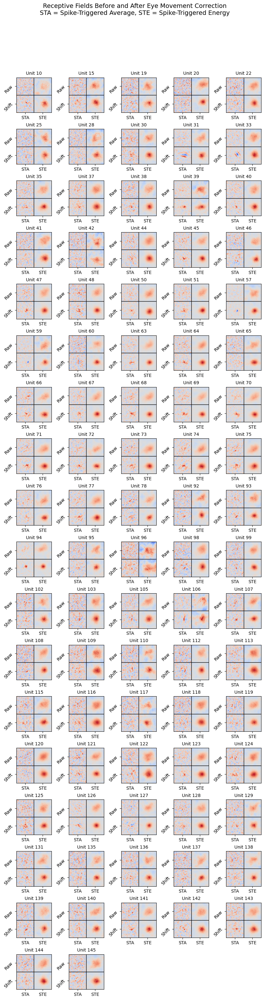


Comparison Summary:
- Analyzed 87 high-quality units
- Grid size: 51×51 pixels
- Each unit shows STA and STE before and after correction
- Look for sharper, more focused receptive fields after correction


In [16]:
#%%

# ============================================================================
# VISUALIZE BEFORE/AFTER COMPARISON
# ============================================================================
# Create comprehensive visualization showing the effect of eye movement correction

print("Creating before/after comparison visualization...")

# Layout parameters for the visualization grid
N_COLS = 5  # Number of columns in the subplot grid
N_ROWS = int(np.ceil(n_units / N_COLS))  # Calculate required rows

# Create figure with subplots for each unit
fig, axes = plt.subplots(N_ROWS, N_COLS, figsize=(N_COLS*2, N_ROWS*2))
axes = axes.flatten() if n_units > 1 else [axes]

# Plot comparison for each unit
for unit_idx in range(n_units):
    ax = axes[unit_idx]

    # Create 2x2 grid within each subplot:
    # Top row: Original data (STA left, STE right)
    # Bottom row: Corrected data (STA left, STE right)

    # Original STA (top-left quadrant)
    ax.imshow(comparison_stas[unit_idx, 0], cmap='coolwarm', vmin=-1, vmax=1,
              extent=[0, 1, 1, 2])

    # Original STE (top-right quadrant)
    ax.imshow(comparison_stes[unit_idx, 0], cmap='coolwarm', vmin=-1, vmax=1,
              extent=[1, 2, 1, 2])

    # Corrected STA (bottom-left quadrant)
    ax.imshow(comparison_stas[unit_idx, 1], cmap='coolwarm', vmin=-1, vmax=1,
              extent=[0, 1, 0, 1])

    # Corrected STE (bottom-right quadrant)
    ax.imshow(comparison_stes[unit_idx, 1], cmap='coolwarm', vmin=-1, vmax=1,
              extent=[1, 2, 0, 1])

    # Add grid lines to separate quadrants
    ax.plot([0, 2], [1, 1], 'k-', linewidth=1)  # Horizontal divider
    ax.plot([1, 1], [0, 2], 'k-', linewidth=1)  # Vertical divider

    # Set axis properties
    ax.set_xlim([0, 2])
    ax.set_ylim([0, 2])  # Invert y-axis for image display
    ax.set_xticks([0.5, 1.5])
    ax.set_xticklabels(['STA', 'STE'])
    ax.set_yticks([0.5, 1.5])
    ax.set_yticklabels(['Shift', 'Raw'], rotation=45)
    ax.set_title(f'Unit {good_units[unit_idx]}', fontsize=10)

# Hide unused subplots
for unit_idx in range(n_units, len(axes)):
    axes[unit_idx].axis('off')

# Adjust layout for better appearance
fig.suptitle('Receptive Fields Before and After Eye Movement Correction\n'
             'STA = Spike-Triggered Average, STE = Spike-Triggered Energy',
             fontsize=14, y=0.98)
fig.subplots_adjust(hspace=0.1, wspace=0.5, top=0.92)
plt.show()

# Print summary statistics
print(f"\nComparison Summary:")
print(f"- Analyzed {n_units} high-quality units")
print(f"- Grid size: {2*GRID_RADIUS+1}×{2*GRID_RADIUS+1} pixels")
print(f"- Each unit shows STA and STE before and after correction")
print(f"- Look for sharper, more focused receptive fields after correction")

In [ ]:

# ============================================================================
# SAVE SHIFTED DATASET FOR FUTURE USE
# ============================================================================
# Save a shifter-calibrated dataset to be used in other analyses

print("Saving shifted dataset for future use...")

# Apply learned shifter function to the original eye position data
print("Applying learned shifter to eye position data...")
with torch.no_grad():
    model.eval()
    model.to('cpu')
    # Convert eye positions to tensor and apply shifter
    eye_positions_tensor = torch.from_numpy(eye_positions_degrees).float()
    predicted_pixel_shifts = model.shifter.layers(eye_positions_tensor).squeeze().numpy()




In [ ]:

# ============================================================================
# 12. GRATINGS ANALYSIS - PHASE TUNING EVALUATION
# ============================================================================
# Test the shifter model using drifting gratings to measure phase tuning improvements

print("Setting up gratings analysis...")
print("This analysis tests whether eye movement correction improves phase tuning precision")
# Create corrected eye position data by adding predicted shifts
# Note: We flip the shifts because eye movements and stimulus shifts are opposite
corrected_eye_positions_pixels = eye_positions_pixels + np.fliplr(predicted_pixel_shifts)

# Create interpolation function for corrected eye positions
corrected_eye_interp = interp1d(eye_times, corrected_eye_positions_pixels,
                               kind='linear', fill_value='extrapolate', axis=0)

# Define ROI for gratings analysis (small region around RF center)
gratings_roi = np.stack([rf_center_pixels, rf_center_pixels + 1], axis=1)

# Generate or load gratings dataset
gratings_dataset_file = data_dir / 'gratings.dset'

if gratings_dataset_file.exists():
    print("Loading existing gratings dataset...")
    gratings_dataset = DictDataset.load(gratings_dataset_file)
else:
    print("Generating gratings datasets (original and corrected)...")

    # Generate dataset with original eye positions
    gratings_dataset = generate_gratings_dataset(
        exp, ks_results, gratings_roi,
        eye_pos_interp, eye_pos_deg_interp, eye_valid_interp,
        dt=dt, metadata=experiment_metadata
    )

    # Generate dataset with corrected eye positions
    gratings_corrected_dataset = generate_gratings_dataset(
        exp, ks_results, gratings_roi,
        corrected_eye_interp, eye_pos_deg_interp, eye_valid_interp,
        dt=dt, metadata=experiment_metadata
    )

    # Add corrected data to main dataset
    gratings_dataset['stim_shifted'] = gratings_corrected_dataset['stim']
    gratings_dataset['stim_phase_shifted'] = gratings_corrected_dataset['stim_phase']

    # Save for future use
    gratings_dataset.save(gratings_dataset_file)
    print(f"Gratings dataset saved to {gratings_dataset_file}")

print(f"Gratings dataset contains {len(gratings_dataset)} timepoints")

In [ ]:
#%%

# ============================================================================
# PREPARE GRATINGS DATA FOR ANALYSIS
# ============================================================================
# Filter gratings data and analyze spatial frequency and orientation tuning

print("Preparing gratings data for phase tuning analysis...")

# Create validity filter for gratings data (same criteria as main dataset)
gratings_validity_filter = np.logical_and.reduce([
    np.abs(gratings_dataset['eyepos'][:, 0]) < MAX_EYE_MOVEMENT,
    np.abs(gratings_dataset['eyepos'][:, 1]) < MAX_EYE_MOVEMENT,
    gratings_dataset['dpi_valid']
]).astype(np.float32)

# Add validity filter to dataset
gratings_dataset['validity_filter'] = gratings_validity_filter

print(f"Valid gratings timepoints: {gratings_validity_filter.sum():,.0f} / {len(gratings_validity_filter):,}")

In [ ]:
#%%

# ============================================================================
# ANALYZE SPATIAL FREQUENCY AND ORIENTATION TUNING
# ============================================================================
# Find optimal stimulus parameters for each neuron using gratings data

from utils.general import fit_sine

print("Analyzing spatial frequency and orientation tuning...")

# Extract neural responses and stimulus parameters
neural_responses = gratings_dataset['robs'].numpy()
spatial_frequencies = gratings_dataset['sf'].numpy()
orientations = gratings_dataset['ori'].numpy()

# Get unique stimulus parameter values
unique_spatial_frequencies = np.unique(spatial_frequencies)
unique_orientations = np.unique(orientations)

print(f"Spatial frequencies tested: {len(unique_spatial_frequencies)} values")
print(f"Orientations tested: {len(unique_orientations)} values")

# Create one-hot encoding for spatial frequency and orientation combinations
# This creates a 3D array: [time, spatial_frequency, orientation]
sf_ori_encoding = np.zeros((len(neural_responses), len(unique_spatial_frequencies), len(unique_orientations)))

for timepoint in range(len(neural_responses)):
    sf_index = np.where(unique_spatial_frequencies == spatial_frequencies[timepoint])[0][0]
    ori_index = np.where(unique_orientations == orientations[timepoint])[0][0]
    sf_ori_encoding[timepoint, sf_index, ori_index] = 1

print("Computing stimulus-triggered averages for parameter tuning...")

# Compute stimulus-triggered averages for each SF/orientation combination
sf_ori_tuning = calc_sta(
    sf_ori_encoding,
    neural_responses.astype(np.float64),
    N_TIME_LAGS,
    reverse_correlate=False,
    progress=True
).numpy() / dt

# Compute spatial frequency tuning (averaged across orientations)
sf_tuning_curves = calc_sta(
    sf_ori_encoding.sum(2, keepdims=True),
    neural_responses.astype(np.float64),
    N_TIME_LAGS,
    reverse_correlate=False,
    progress=True
).numpy().squeeze() / dt

print("Finding optimal parameters for each neuron...")

# Find optimal temporal lag for each neuron
temporal_response_strength = np.linalg.norm(sf_tuning_curves, axis=2)
optimal_temporal_lags = np.argmax(temporal_response_strength, axis=1)

# Find optimal spatial frequency for each neuron
sf_response_strength = np.linalg.norm(sf_tuning_curves[:, optimal_temporal_lags], axis=1)
optimal_spatial_frequencies = np.argmax(sf_response_strength, axis=1)

# Calculate spatial frequency signal-to-noise ratio
sf_signal_to_noise = (sf_response_strength[np.arange(len(sf_response_strength)), optimal_spatial_frequencies] /
                     np.mean(sf_response_strength, axis=1))

# Find optimal orientation for each neuron
orientation_tuning = sf_ori_tuning[np.arange(len(sf_ori_tuning)), optimal_temporal_lags, optimal_spatial_frequencies]
optimal_orientations = np.argmax(orientation_tuning, axis=1)

# Calculate orientation signal-to-noise ratio
ori_signal_to_noise = (orientation_tuning[np.arange(len(orientation_tuning)), optimal_orientations] /
                      np.mean(orientation_tuning, axis=1))

print(f"Optimal temporal lags: {optimal_temporal_lags.min()}-{optimal_temporal_lags.max()} frames")
print(f"Optimal spatial frequencies: {unique_spatial_frequencies[optimal_spatial_frequencies].min():.2f}-{unique_spatial_frequencies[optimal_spatial_frequencies].max():.2f} cycles/deg")
print(f"Mean SF SNR: {sf_signal_to_noise.mean():.2f} ± {sf_signal_to_noise.std():.2f}")
print(f"Mean orientation SNR: {ori_signal_to_noise.mean():.2f} ± {ori_signal_to_noise.std():.2f}")

In [ ]:
#%%

# ============================================================================
# EXTRACT PHASE INFORMATION FOR OPTIMAL STIMULI
# ============================================================================
# For each neuron, extract phase and spike data for its preferred stimulus parameters

print("Extracting phase information for optimal stimuli...")

# Initialize lists to store phase and spike data
original_phases = []  # Stimulus phases without eye movement correction
original_spikes = []  # Corresponding spike counts
corrected_phases = []  # Stimulus phases with eye movement correction
corrected_spikes = []  # Corresponding spike counts

# Process each neuron individually
for unit_idx in tqdm(range(len(sf_tuning_curves)), desc="Processing units"):
    # Get optimal parameters for this neuron
    sf_idx = optimal_spatial_frequencies[unit_idx]
    ori_idx = optimal_orientations[unit_idx]
    lag = optimal_temporal_lags[unit_idx]

    # Find timepoints where this neuron's preferred stimulus was shown
    preferred_stimulus_times = np.where(sf_ori_encoding[:, sf_idx, ori_idx] > 0)[0]

    # Only keep timepoints that have sufficient history for the temporal lag
    valid_times = preferred_stimulus_times[(preferred_stimulus_times + lag) < len(neural_responses)]

    # Extract stimulus phases for original data
    stimulus_phases_original = gratings_dataset['stim_phase'][valid_times].numpy().squeeze()
    if stimulus_phases_original.ndim == 3:
        # If spatial, take center pixel
        center_y, center_x = stimulus_phases_original.shape[1]//2, stimulus_phases_original.shape[2]//2
        stimulus_phases_original = stimulus_phases_original[:, center_y, center_x]

    # Extract stimulus phases for corrected data
    stimulus_phases_corrected = gratings_dataset['stim_phase_shifted'][valid_times].numpy().squeeze()
    if stimulus_phases_corrected.ndim == 3:
        # If spatial, take center pixel
        center_y, center_x = stimulus_phases_corrected.shape[1]//2, stimulus_phases_corrected.shape[2]//2
        stimulus_phases_corrected = stimulus_phases_corrected[:, center_y, center_x]

    # Extract corresponding spike counts (with temporal lag)
    spike_counts = neural_responses[valid_times + lag, unit_idx]

    # Extract validity filter (with temporal lag)
    validity_flags = gratings_dataset['validity_filter'].numpy().squeeze()[valid_times + lag]

    # Remove invalid timepoints (off-screen stimuli or unreliable eye tracking)
    valid_original = (stimulus_phases_original > 0) & (validity_flags > 0)
    original_phases.append(stimulus_phases_original[valid_original])
    original_spikes.append(spike_counts[valid_original])

    valid_corrected = (stimulus_phases_corrected > 0) & (validity_flags > 0)
    corrected_phases.append(stimulus_phases_corrected[valid_corrected])
    corrected_spikes.append(spike_counts[valid_corrected])

print(f"Extracted phase data for {len(original_phases)} units")

# Calculate summary statistics
total_original_samples = sum(len(phases) for phases in original_phases)
total_corrected_samples = sum(len(phases) for phases in corrected_phases)
print(f"Total original samples: {total_original_samples:,}")
print(f"Total corrected samples: {total_corrected_samples:,}")
print(f"Average samples per unit: {total_original_samples/len(original_phases):.0f}")

In [ ]:
#%%

# ============================================================================
# COMPUTE PHASE TUNING CURVES
# ============================================================================
# Bin phase data and compute firing rates for each phase bin

print("Computing phase tuning curves...")

# Phase binning parameters
N_PHASE_BINS = 8  # Number of phase bins (45° each)
phase_bin_edges = np.linspace(0, 2*np.pi, N_PHASE_BINS + 1)
phase_bin_centers = np.rad2deg((phase_bin_edges[:-1] + phase_bin_edges[1:]) / 2)

# Initialize arrays to store phase tuning data
n_units_phase = len(original_phases)
phase_counts_original = np.zeros((n_units_phase, N_PHASE_BINS))
spike_counts_original = np.zeros((n_units_phase, N_PHASE_BINS))
phase_response_original = np.zeros((n_units_phase, N_PHASE_BINS))
phase_response_sem_original = np.zeros((n_units_phase, N_PHASE_BINS))

phase_counts_corrected = np.zeros((n_units_phase, N_PHASE_BINS))
spike_counts_corrected = np.zeros((n_units_phase, N_PHASE_BINS))
phase_response_corrected = np.zeros((n_units_phase, N_PHASE_BINS))
phase_response_sem_corrected = np.zeros((n_units_phase, N_PHASE_BINS))

# Compute phase tuning for each unit
for unit_idx in tqdm(range(n_units_phase), desc="Computing phase tuning"):

    # Process original (uncorrected) data
    unit_phases_orig = original_phases[unit_idx]
    unit_spikes_orig = original_spikes[unit_idx]

    # Assign each phase sample to a bin
    phase_bin_indices = np.digitize(unit_phases_orig, phase_bin_edges) - 1
    phase_bin_indices = np.clip(phase_bin_indices, 0, N_PHASE_BINS - 1)  # Handle edge cases

    # Compute statistics for each phase bin
    for bin_idx in range(N_PHASE_BINS):
        bin_mask = (phase_bin_indices == bin_idx)
        phase_counts_original[unit_idx, bin_idx] = np.sum(bin_mask)

        if np.sum(bin_mask) > 0:
            bin_spikes = unit_spikes_orig[bin_mask]
            spike_counts_original[unit_idx, bin_idx] = bin_spikes.sum() / dt
            phase_response_sem_original[unit_idx, bin_idx] = (bin_spikes.std() /
                                                            np.sqrt(len(bin_spikes)) / dt)

    # Convert to firing rates (spikes per second)
    with np.errstate(divide='ignore', invalid='ignore'):
        phase_response_original[unit_idx] = (spike_counts_original[unit_idx] /
                                           phase_counts_original[unit_idx])

    # Process corrected data
    unit_phases_corr = corrected_phases[unit_idx]
    unit_spikes_corr = corrected_spikes[unit_idx]

    phase_bin_indices = np.digitize(unit_phases_corr, phase_bin_edges) - 1
    phase_bin_indices = np.clip(phase_bin_indices, 0, N_PHASE_BINS - 1)

    for bin_idx in range(N_PHASE_BINS):
        bin_mask = (phase_bin_indices == bin_idx)
        phase_counts_corrected[unit_idx, bin_idx] = np.sum(bin_mask)

        if np.sum(bin_mask) > 0:
            bin_spikes = unit_spikes_corr[bin_mask]
            spike_counts_corrected[unit_idx, bin_idx] = bin_spikes.sum() / dt
            phase_response_sem_corrected[unit_idx, bin_idx] = (bin_spikes.std() /
                                                             np.sqrt(len(bin_spikes)) / dt)

    with np.errstate(divide='ignore', invalid='ignore'):
        phase_response_corrected[unit_idx] = (spike_counts_corrected[unit_idx] /
                                            phase_counts_corrected[unit_idx])

# Replace NaN values with 0 (occurs when no samples in a bin)
phase_response_original = np.nan_to_num(phase_response_original)
phase_response_corrected = np.nan_to_num(phase_response_corrected)
phase_response_sem_original = np.nan_to_num(phase_response_sem_original)
phase_response_sem_corrected = np.nan_to_num(phase_response_sem_corrected)

print(f"Computed phase tuning curves for {n_units_phase} units")
print(f"Phase bins: {N_PHASE_BINS} bins of {360/N_PHASE_BINS:.0f}° each")

In [ ]:
#%%

# ============================================================================
# FIT SINUSOIDAL MODELS TO PHASE TUNING DATA
# ============================================================================
# Quantify phase tuning strength using sinusoidal fits

print("Fitting sinusoidal models to phase tuning data...")

# Minimum spike count threshold for reliable fitting
MIN_SPIKES_ORIGINAL = 50
MIN_SPIKES_CORRECTED = 50

# Fit sinusoidal models to original data
original_sine_fits = []
for unit_idx in tqdm(range(n_units_phase), desc="Fitting original data"):
    unit_phases = original_phases[unit_idx]
    unit_spikes = original_spikes[unit_idx]

    # Only fit if we have sufficient data
    if np.sum(unit_spikes) < MIN_SPIKES_ORIGINAL:
        original_sine_fits.append(None)
        continue

    # Fit sinusoidal model: firing_rate = amplitude * sin(phase + phase_offset) + baseline
    try:
        fit_result = fit_sine(unit_phases, unit_spikes, omega=1.0, variance_source='mse')
        original_sine_fits.append(fit_result)
    except Exception as e:
        print(f"Fit failed for unit {unit_idx}: {e}")
        original_sine_fits.append(None)

# Fit sinusoidal models to corrected data
corrected_sine_fits = []
for unit_idx in tqdm(range(n_units_phase), desc="Fitting corrected data"):
    unit_phases = corrected_phases[unit_idx]
    unit_spikes = corrected_spikes[unit_idx]

    if np.sum(unit_spikes) < MIN_SPIKES_CORRECTED:
        corrected_sine_fits.append(None)
        continue

    try:
        fit_result = fit_sine(unit_phases, unit_spikes, omega=1.0, variance_source='mse')
        corrected_sine_fits.append(fit_result)
    except Exception as e:
        print(f"Fit failed for unit {unit_idx}: {e}")
        corrected_sine_fits.append(None)

# Count successful fits
n_successful_original = sum(1 for fit in original_sine_fits if fit is not None)
n_successful_corrected = sum(1 for fit in corrected_sine_fits if fit is not None)

print(f"Successful sine fits:")
print(f"  Original data: {n_successful_original}/{n_units_phase} units")
print(f"  Corrected data: {n_successful_corrected}/{n_units_phase} units")

In [ ]:
#%%

# ============================================================================
# VISUALIZE EXAMPLE PHASE TUNING RESULTS
# ============================================================================
# Show detailed analysis for a representative neuron

# Select an example unit for detailed visualization
EXAMPLE_UNIT = 90

print(f"Creating detailed visualization for unit {EXAMPLE_UNIT}...")
def plot_phase_tuning_with_fit(fit_result, phase_data, spike_data, ax=None, title=""):
    """
    Plot phase tuning curve with sinusoidal fit overlay.

    Parameters:
    -----------
    fit_result : dict
        Results from sine fitting function
    phase_data : array
        Phase values
    spike_data : array
        Corresponding spike counts
    ax : matplotlib axis, optional
        Axis to plot on
    title : str
        Plot title
    """
    if fit_result is None:
        if ax is not None:
            ax.text(0.5, 0.5, 'Insufficient data\nfor fitting',
                   ha='center', va='center', transform=ax.transAxes)
            ax.set_title(title)
        return

    # Extract fit parameters
    amplitude = fit_result['amplitude']
    amplitude_se = fit_result['amplitude_se']
    phase_offset = fit_result['phase_offset_rad']
    baseline = fit_result['C']
    modulation_index = fit_result['modulation_index']
    modulation_index_se = fit_result['modulation_index_se']

    # Check for valid fit
    if (np.isnan(modulation_index) or np.isnan(modulation_index_se) or
        np.isnan(amplitude) or np.isnan(amplitude_se) or np.isnan(phase_offset)):
        if ax is not None:
            ax.text(0.5, 0.5, 'Fit failed\n(NaN values)',
                   ha='center', va='center', transform=ax.transAxes)
            ax.set_title(title)
        return

    # Generate smooth curve for visualization
    smooth_phases = np.linspace(0, 2*np.pi, 100)
    smooth_fit = amplitude * np.sin(smooth_phases + phase_offset) + baseline
    smooth_fit_upper = (amplitude + amplitude_se) * np.sin(smooth_phases + phase_offset) + baseline
    smooth_fit_lower = (amplitude - amplitude_se) * np.sin(smooth_phases + phase_offset) + baseline

    if ax is None:
        fig, ax = plt.subplots(figsize=(6, 4))

    # Plot fitted curve with confidence interval
    ax.plot(np.rad2deg(smooth_phases), smooth_fit / dt, 'red', linewidth=2, label='Fit')
    ax.fill_between(np.rad2deg(smooth_phases), smooth_fit_lower / dt, smooth_fit_upper / dt,
                   color='red', alpha=0.3, label='±1 SE')

    # Set axis properties
    ax.set_ylim(bottom=0)
    ax.set_xlabel('Phase (degrees)')
    ax.set_ylabel('Firing Rate (Hz)')
    ax.set_title(f'{title}\nMI: {modulation_index:.3f} ± {modulation_index_se:.3f}')
    ax.legend()

# Create comparison plot for the example unit
if (EXAMPLE_UNIT < len(original_sine_fits) and EXAMPLE_UNIT < len(corrected_sine_fits)):

    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Plot original data with phase tuning curve
    axes[0].errorbar(phase_bin_centers, phase_response_original[EXAMPLE_UNIT],
                    yerr=phase_response_sem_original[EXAMPLE_UNIT],
                    fmt='o-', capsize=5, label='Data', zorder=10)

    plot_phase_tuning_with_fit(original_sine_fits[EXAMPLE_UNIT],
                              original_phases[EXAMPLE_UNIT],
                              original_spikes[EXAMPLE_UNIT],
                              ax=axes[0], title=f'Unit {EXAMPLE_UNIT} - Original')

    # Plot corrected data with phase tuning curve
    axes[1].errorbar(phase_bin_centers, phase_response_corrected[EXAMPLE_UNIT],
                    yerr=phase_response_sem_corrected[EXAMPLE_UNIT],
                    fmt='o-', capsize=5, label='Data', zorder=10)

    plot_phase_tuning_with_fit(corrected_sine_fits[EXAMPLE_UNIT],
                              corrected_phases[EXAMPLE_UNIT],
                              corrected_spikes[EXAMPLE_UNIT],
                              ax=axes[1], title=f'Unit {EXAMPLE_UNIT} - Corrected')

    plt.tight_layout()
    plt.show()

    # Print comparison statistics
    orig_fit = original_sine_fits[EXAMPLE_UNIT]
    corr_fit = corrected_sine_fits[EXAMPLE_UNIT]

    if orig_fit is not None and corr_fit is not None:
        print(f"\nExample Unit {EXAMPLE_UNIT} Comparison:")
        print(f"Original MI: {orig_fit['modulation_index']:.3f} ± {orig_fit['modulation_index_se']:.3f}")
        print(f"Corrected MI: {corr_fit['modulation_index']:.3f} ± {corr_fit['modulation_index_se']:.3f}")
        print(f"Improvement: {corr_fit['modulation_index'] - orig_fit['modulation_index']:.3f}")
else:
    print(f"Example unit {EXAMPLE_UNIT} not available for detailed comparison")

In [ ]:
#%%

# ============================================================================
# 13. POPULATION-LEVEL ANALYSIS AND SUMMARY
# ============================================================================
# Analyze the overall effect of eye movement correction across all neurons

print("Performing population-level analysis...")

# Extract modulation indices from sine fits
modulation_index_original = np.array([
    fit['modulation_index'] if fit is not None else np.nan
    for fit in original_sine_fits
])

modulation_index_original_se = np.array([
    fit['modulation_index_se'] if fit is not None else np.nan
    for fit in original_sine_fits
])

modulation_index_corrected = np.array([
    fit['modulation_index'] if fit is not None else np.nan
    for fit in corrected_sine_fits
])

modulation_index_corrected_se = np.array([
    fit['modulation_index_se'] if fit is not None else np.nan
    for fit in corrected_sine_fits
])

# Calculate total spike counts for each unit
total_spike_counts = np.array([
    np.sum(original_spikes[unit_idx]) if unit_idx < len(original_spikes) else 0
    for unit_idx in range(n_units_phase)
])

# ============================================================================
# FILTER UNITS BY ORIENTATION SIGNAL-TO-NOISE RATIO
# ============================================================================
# Only include units with orientation SNR >= 2 in the population analysis

ORIENTATION_SNR_THRESHOLD = 2.0

print(f"Filtering units by orientation signal-to-noise ratio...")
print(f"Threshold: {ORIENTATION_SNR_THRESHOLD}")

# Create mask for units with sufficient orientation tuning
high_ori_snr_mask = ori_signal_to_noise >= ORIENTATION_SNR_THRESHOLD

# Apply filter to all analysis variables
modulation_index_original_filtered = modulation_index_original[high_ori_snr_mask]
modulation_index_corrected_filtered = modulation_index_corrected[high_ori_snr_mask]
ori_signal_to_noise_filtered = ori_signal_to_noise[high_ori_snr_mask]
total_spike_counts_filtered = total_spike_counts[high_ori_snr_mask]

print(f"Units before filtering: {len(modulation_index_original)}")
print(f"Units after filtering (ori SNR >= {ORIENTATION_SNR_THRESHOLD}): {len(modulation_index_original_filtered)}")
print(f"Filtered out: {len(modulation_index_original) - len(modulation_index_original_filtered)} units")

# Create population comparison plot with filtered data
plt.figure(figsize=(10, 8))

# Main scatter plot using filtered data
scatter = plt.scatter(modulation_index_original_filtered, modulation_index_corrected_filtered,
                     c=ori_signal_to_noise_filtered, cmap='viridis', alpha=0.7, s=50)
for i, unit_id in enumerate(high_ori_snr_mask.nonzero()[0]):
    plt.text(modulation_index_original_filtered[i]+.02, 
             modulation_index_corrected_filtered[i]+.01,
             f'{unit_id}', fontsize=8, ha='center', va='center')
# Add unity line
max_mi = max(np.nanmax(modulation_index_original_filtered), np.nanmax(modulation_index_corrected_filtered))
plt.plot([0, max_mi], [0, max_mi], 'k--', alpha=0.5, label='Unity line')

# Formatting
plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('Original Modulation Index', fontsize=12)
plt.ylabel('Corrected Modulation Index', fontsize=12)
plt.title(f'Phase Tuning: Effect of Eye Movement Correction\n'
          f'Units with Orientation SNR ≥ {ORIENTATION_SNR_THRESHOLD} (Points above unity line show improvement)', fontsize=14)

# Add colorbar
cbar = plt.colorbar(scatter)
cbar.set_label('Orientation Signal-to-Noise Ratio', fontsize=12)

# Add statistics text using filtered data
valid_pairs_filtered = ~(np.isnan(modulation_index_original_filtered) | np.isnan(modulation_index_corrected_filtered))
n_valid_filtered = np.sum(valid_pairs_filtered)

if n_valid_filtered > 0:
    mean_original_filtered = np.nanmean(modulation_index_original_filtered[valid_pairs_filtered])
    mean_corrected_filtered = np.nanmean(modulation_index_corrected_filtered[valid_pairs_filtered])
    improvement_filtered = mean_corrected_filtered - mean_original_filtered

    # Count units that improved
    improved_filtered = np.sum(modulation_index_corrected_filtered[valid_pairs_filtered] >
                              modulation_index_original_filtered[valid_pairs_filtered])

    stats_text = (f'Valid units (ori SNR ≥ {ORIENTATION_SNR_THRESHOLD}): {n_valid_filtered}\n'
                 f'Mean original MI: {mean_original_filtered:.3f}\n'
                 f'Mean corrected MI: {mean_corrected_filtered:.3f}\n'
                 f'Mean improvement: {improvement_filtered:.3f}\n'
                 f'Units improved: {improved_filtered}/{n_valid_filtered} ({100*improved_filtered/n_valid_filtered:.1f}%)')

    plt.text(0.98, 0.02, stats_text, transform=plt.gca().transAxes,
             verticalalignment='bottom', horizontalalignment='right',
             bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()